In [1]:
from IPython.display import display
from IPython.display import HTML
import IPython.core.display as di # Example: di.display_html('<h3>%s:</h3>' % str, raw=True)

# This line will hide code by default when the notebook is exported as HTML
di.display_html('<script>jQuery(function() {if (jQuery("body.notebook_app").length == 0) { jQuery(".input_area").toggle(); jQuery(".prompt").toggle();}});</script>', raw=True)

# This line will add a button to toggle visibility of code blocks, for use with the HTML export version
di.display_html('''<button onclick="jQuery('.input_area').toggle(); jQuery('.prompt').toggle();">Toggle code</button>''', raw=True)

Toggle code

In [2]:
import os
from pathlib import Path
import pandas as pd
import numpy as np
import boto3
import datetime
#import geopandas
#from shapely.geometry import Point, LineString
#from shapely import wkt

import matplotlib.pyplot as plt
from matplotlib.dates import DateFormatter, DayLocator
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
import fun_eda, fun_s3

In [3]:
##### Load dictionario tiles - ageb
DICT_TILES_AGEB = "~/bj/data/rutas_tiles/id_tiles_ageb.csv"
dict_tiles_ageb = pd.read_csv(DICT_TILES_AGEB) 

In [4]:
##### Load datos de movilidad en tiles
bucket_name = 'movicovid'
fname = '{}/{}/{}'.format('raw', 'tiles_ageb', 'movimiento_tiles_19072020.csv')
data_tiles = fun_s3.abre_file_como_df(bucket_name, fname)

In [5]:
print("Num de registros: {:0,.0f}".format(data_tiles.shape[0]))
data_tiles.head(3)

Num de registros: 3,286,785


,geometry,date_time,start_polygon_id,start_polygon_name,end_polygon_id,end_polygon_name,length_km,tile_size,country,level,...,percent_change,is_statistically_significant,z_score,start_lat,start_lon,end_lat,end_lon,start_quadkey,end_quadkey,fecha
0,LINESTRING (-99.04174804687501 19.362975803871...,2020-03-17 00:00:00,589187,Iztapalapa,589187,Iztapalapa,4.610109,14,MX,LEVEL3,...,-18.181818,0,-0.648886,19.349192,-99.056864,19.349192,-99.056864,2331003322302,2331003322312,./inp/tiles/21072020/Mexico City Coronavirus D...
1,LINESTRING (-99.04174804687501 19.362975803871...,2020-03-17 00:00:00,589187,Iztapalapa,589187,Iztapalapa,5.154586,14,MX,LEVEL3,...,-32.160804,0,-1.780183,19.349192,-99.056864,19.349192,-99.056864,2331003322302,2331003322330,./inp/tiles/21072020/Mexico City Coronavirus D...
2,LINESTRING (-99.04174804687501 19.362975803871...,2020-03-17 00:00:00,589187,Iztapalapa,590171,Nezahualcóyotl,5.153930,14,MX,LEVEL3,...,-51.127820,0,-1.936937,19.349192,-99.056864,19.422548,-99.023699,2331003322302,2331003322310,./inp/tiles/21072020/Mexico City Coronavirus D...


In [6]:
# Separamos fecha y hora
data_tiles[['fecha', 'hora']] = data_tiles['date_time'].str.split(' ', 2, expand=True)
####################################   CAMBIO TIPO DE VARIABLES
data_tiles['start_polygon_name'] = data_tiles['start_polygon_name'].astype('category')
data_tiles['end_polygon_name'] = data_tiles['end_polygon_name'].astype('category')
data_tiles['fecha'] = pd.to_datetime(data_tiles['fecha'])
data_tiles['hr'] = data_tiles['hora'].str.slice(start=0, stop=2).astype(int)
### Añado una columna que contabilice el numero de semanas
data_tiles['num_semana'] = data_tiles['fecha'].dt.week
### Añado una columna para el dia de la semana
dict_days = {0:'Lunes',1:'Martes',2:'Miércoles',3:'Jueves',4:'Viernes',5:'Sábado',6:'Domingo'}
data_tiles['dia_semana'] = data_tiles['fecha'].dt.dayofweek.map(dict_days)
# Separamos las coordenadas
data_tiles['geometry'] = data_tiles['geometry'].str.replace('LINESTRING',"").str.strip()
data_tiles[['origen', 'destino']] = data_tiles['geometry'].astype(str).str.replace("(", "").str.replace(")","").str.strip().str.split(',', 2, expand=True)
data_tiles[['origen_long', 'origen_lat']] = data_tiles['origen'].str.strip().str.split(' ', 2, expand=True).astype('float64').round(8).astype('str')
data_tiles[['destino_long', 'destino_lat']] = data_tiles['destino'].str.strip().str.split(' ', 2, expand=True).astype('float64').round(8).astype('str')
#data_tiles.columns

In [7]:
data_tiles['coord_origen'] = data_tiles['origen_long'] + ' ' + data_tiles['origen_lat']
data_tiles['coord_destino'] = data_tiles['destino_long'] + ' ' + data_tiles['destino_lat']

In [8]:
print(dict_tiles_ageb.shape)
dict_tiles_ageb['coord'] = dict_tiles_ageb['long'].astype(str) + ' ' + dict_tiles_ageb['lat'].astype(str)
dict_tiles_ageb['ageb'] = dict_tiles_ageb['CVE_AGEB'].astype('str').str.zfill(4)
dict_ageb = dict(zip(dict_tiles_ageb.coord, dict_tiles_ageb.ageb))
dict_tiles_ageb.head(5)
###
# Cleve AGEB completa 23 digitos (str)
# que es id?
# tipo para manejar las coordenadas (float, string, cat?)


(5743, 4)


,long,lat,id,CVE_AGEB,coord,ageb
0,-99.305420,19.362976,411,335,-99.30541992 19.3629758,0335
1,-99.283447,19.321511,386,157,-99.28344727 19.3215109,0157
2,-99.239502,19.217803,324,368,-99.23950195 19.21780263,0368
3,-99.151611,19.155546,151,1250,-99.15161133 19.15554622,1250
4,-99.129639,19.197053,125,1829,-99.12963867 19.19705311,1829


In [9]:
data_tiles['AGEB_origen'] = data_tiles['coord_origen'].map(dict_ageb)
data_tiles['AGEB_destino'] = data_tiles['coord_destino'].map(dict_ageb)

In [10]:
data_tiles['ruta'] = data_tiles['AGEB_origen'].astype('str') + ' - ' + data_tiles['AGEB_destino'].astype('str')

In [11]:
####################################     INTER-RUTAS
# Rutas entre alcaldias/municipios
data_tiles = data_tiles[data_tiles['origen']!=data_tiles['destino']]
print(data_tiles.shape)
# *NO hay rutas en el mismo tile

(3286785, 38)


In [12]:
####################################     DATAFRAMES
### Hacemos df por ventana de tiempo & solo en dias habiles
df = data_tiles[['ruta', 'geometry', 'start_polygon_name', 'end_polygon_name', 'length_km', 'n_crisis', 'n_baseline', 
                 'n_difference', 'percent_change', 'fecha', 'hora', 'hr', 'num_semana', 'dia_semana','origen', 'destino',
                 'origen_long', 'origen_lat', 'destino_long', 'destino_lat']]
    
rutas_8hr =df.loc[(data_tiles['hr']==8) & (data_tiles['dia_semana']!='Sábado') &
                                (data_tiles['dia_semana']!='Domingo')].reset_index(drop=True).copy()
rutas_16hr = df.loc[(data_tiles['hr']==16) & (data_tiles['dia_semana']!='Sábado') &
                                (data_tiles['dia_semana']!='Domingo')].reset_index(drop=True).copy()
rutas_0hr = df.loc[(data_tiles['hr']==0) & (data_tiles['dia_semana']!='Sábado') &
                                (data_tiles['dia_semana']!='Domingo')].reset_index(drop=True).copy()

In [13]:
# Total de registros por ventana de tiempo
a = rutas_8hr.shape[0]
b = rutas_16hr.shape[0]
c = rutas_0hr.shape[0]
print('Total registros: {:0,.0f}'.format(a+b+c))
print('08 hrs: {:0,.0f} \n16 hrs: {:0,.0f} \n00 hrs: {:0,.0f}'.format(a, b, c))
print()
# Rutas en tiles por ventana de tiempo
a = rutas_8hr['geometry'].unique().shape[0]
b = rutas_16hr['geometry'].unique().shape[0]
c = rutas_0hr['geometry'].unique().shape[0]
print("Rutas en tiles: {:0,.0f}".format(a+b+c))
print("08 hrs: {:0,.0f} \n16 hrs: {:0,.0f} \n00 hrs: {:0,.0f}".format(a,b,c))

# Rutas en tiles por ventana de tiempo
a = rutas_8hr['ruta'].unique().shape[0]
b = rutas_16hr['ruta'].unique().shape[0]
c = rutas_0hr['ruta'].unique().shape[0]
print("Rutas en tiles: {:0,.0f}".format(a+b+c))
print("08 hrs: {:0,.0f} \n16 hrs: {:0,.0f} \n00 hrs: {:0,.0f}".format(a,b,c))

Total registros: 2,439,643
08 hrs: 687,906 
16 hrs: 794,342 
00 hrs: 957,395

Rutas en tiles: 53,076
08 hrs: 14,995 
16 hrs: 17,272 
00 hrs: 20,809
Rutas en tiles: 51,969
08 hrs: 14,704 
16 hrs: 16,934 
00 hrs: 20,331


In [14]:
# Funcion para determinar las rutas que pertenecen a los grupos
# los grupos se calculan con base al promedio a partir del 23 de Marzo
def rutas_con_reduccion_menor_al_thr(df_rutas, threshold):
    
    # Calculamos el promedio de cambio a partir del 23 de marzo
    avg_change = df_rutas.loc[:,'2020-03-23':].mean(axis=1, skipna=True)
    # Obtenemos los index de las rutas mayores al threshold
    avg_change_index = avg_change[avg_change>=threshold].index
    # Obtenemos la base cuyo promedio es mayor al threshold
    grupo = df_rutas.loc[avg_change_index]

    return grupo

In [15]:
def bins_para_graficar(df_rutas, threshold, step):
    grupo = []
    
    # Calculamos el promedio de cambio a partir del 23 de marzo
    avg_change = df_rutas.loc[:,'2020-03-23':].mean(axis=1, skipna=True)
    
    bins =  range(threshold, -threshold+1, step)
    # Encontramos los cuartiles
    grupos = pd.cut(avg_change, bins)
    
      
    for cat in grupos.cat.categories:
        index_grupo =  grupos[grupos == cat].index
        grupo_cat = df_rutas.loc[index_grupo]
        grupo.append(grupo_cat)

    return grupo, grupos.cat.categories

In [16]:
def grafica_cambio_en_en_tiempo_grupos_estatica(df_grupo, rutas, subtitulo):
    #df_grupo: df que contiene las rutas
    #rutas: array con los nombres de las rutas
    #dias: array con los dias del periodo
    #group_name: str con el nombre del grupo
    #flag: para cambiar el titulo
    sns.set_style("darkgrid")
    fig, ax = plt.subplots(figsize=(20,10))
    
    for ruta in rutas:
        ax.plot(df_grupo.loc[ruta])
    plt.axhline(y=0, color='red', linestyle='solid')
    
    myFmt = DateFormatter("%d-%b-%Y")
    ax.xaxis.set_major_formatter(myFmt)
    ax.xaxis.set_major_locator(DayLocator(interval=5))
    ax.xaxis.set_minor_locator(DayLocator())
    
    plt.title('{} rutas con reducciones promedio en el intervalo {}'.format(subtitulo[0], subtitulo[1]), fontsize=16)
        
    plt.ylabel('Porcentaje de cambio con respecto al baseline', fontsize='14')
    
   # plt.axvline(x=datetime.datetime(2020, 3, 23), color='red')
   # plt.axvline(x=datetime.datetime(2020, 3, 13), color='red', linestyle='dashed')
    
    plt.xticks(fontsize='14', rotation='vertical')
    plt.yticks(fontsize='14')
    plt.show()

In [17]:
# Graficas por grupos
# Cambio porcentual diario por ruta, todo el periodo
#rutas = grupo1.index
#dias = grupo1.columns

def grafica_cambio_en_en_tiempo_grupos(df_grupo, rutas, subtitulo):
    #df_grupo: df que contiene las rutas
    #rutas: array con los nombres de las rutas
    #dias: array con los dias del periodo
    #group_name: str con el nombre del grupo
    #flag: para cambiar el titulo
    
    fig = go.Figure()
        
    for ruta in rutas:
        #ax.plot(df_grupo.loc[ruta])
        fig.add_trace(go.Scatter(x=df_grupo.columns, y=df_grupo.loc[ruta], name=ruta, hovertext=ruta))
        
        fig.add_shape(
            # Line Vertical
            dict(
                type="line",
                x0=datetime.datetime(2020, 3, 23),
                y0=min(df_grupo.loc[ruta]),
                x1=datetime.datetime(2020, 3, 23),
                y1=max(df_grupo.loc[ruta]),
                line=dict(
                color="Red",
                width=3)
        )
    )
        
    titulo = '{} rutas con reducciones promedio en el intervalo {}'.format(subtitulo[0], subtitulo[1])
        
    fig.update_layout( 
        yaxis = dict(
            tickmode = 'linear',
            tick0 = -100, #round(min(df_grupo.loc[ruta])) ,
            dtick = 10
            ),
        title=titulo,
        yaxis_title="Porcentaje de cambio con respecto al baseline",
        xaxis_title="Dias",
        #legend_title="Legend Title",
        font=dict(
            #family="Courier New, monospace",
            size=12,
            color="Black"),
        showlegend=False,
        autosize=False,
        width=1000,
        height=500,
    )    
    
    fig.show()

### Params

In [18]:
UMBRAL_CAMBIO_PORCENTUAL = -10
STEP = 2

### 1. Rutas por tiles: 08 hrs

In [19]:
### Reshape
rutas_8hr_panel = rutas_8hr.groupby(['ruta', 'fecha']).mean()['percent_change'].unstack()
print(rutas_8hr_panel.shape)
rutas_8hr_panel.head(3)

(14704, 87)


fecha,2020-03-17,2020-03-18,2020-03-19,2020-03-20,2020-03-23,2020-03-24,2020-03-25,2020-03-26,2020-03-27,2020-04-01,...,2020-07-06,2020-07-07,2020-07-08,2020-07-09,2020-07-10,2020-07-13,2020-07-14,2020-07-15,2020-07-16,2020-07-17
ruta,,,,,,,,,,,,,,,,,,,,,
0013 - 0013,7.294193,10.179886,11.837678,14.655045,12.531858,16.324264,18.487910,19.430059,20.460925,19.831211,...,15.471501,18.442970,17.538839,17.235730,18.111981,13.342794,15.973582,17.013199,16.577431,17.683557
0013 - 0028,4.060914,6.907895,-11.229135,-10.794603,-3.061224,-15.397631,-25.164474,-26.403642,-29.535232,-11.184211,...,-11.564626,2.368866,-10.361842,-29.438543,-13.793103,-9.863946,-3.553299,-2.960526,-20.333839,-13.793103
0013 - 0061,-28.763441,-31.343284,-12.828947,-31.893688,-31.226766,-51.612903,-55.223881,-44.078947,-53.488372,-55.223881,...,-25.650558,-46.236559,-38.805970,-30.921053,-28.571429,-20.074349,-32.795699,-40.298507,-30.921053,-43.521595


In [20]:
# Determinacion de los intervalos para los grupos
# Usamos el UMBRAL_CAMBIO_PORCENTUAL
grupo_8h =  rutas_con_reduccion_menor_al_thr(rutas_8hr_panel, UMBRAL_CAMBIO_PORCENTUAL)
print('Número de rutas con reducciones menores al {}% y mayores al {}: {:0,.0f}'.format(-UMBRAL_CAMBIO_PORCENTUAL, UMBRAL_CAMBIO_PORCENTUAL, grupo_8h.shape[0]))

Número de rutas con reducciones menores al 10% y mayores al -10: 3,797


In [21]:
grupos_grafica, subinterval = bins_para_graficar(grupo_8h, UMBRAL_CAMBIO_PORCENTUAL, STEP)

for i in range(0, len(grupos_grafica)):
    print("En el intervalo {} hay {:0,.0f} rutas".format(subinterval[i], grupos_grafica[i].shape[0]) )

En el intervalo (-10, -8] hay 343 rutas
En el intervalo (-8, -6] hay 321 rutas
En el intervalo (-6, -4] hay 321 rutas
En el intervalo (-4, -2] hay 338 rutas
En el intervalo (-2, 0] hay 392 rutas
En el intervalo (0, 2] hay 301 rutas
En el intervalo (2, 4] hay 231 rutas
En el intervalo (4, 6] hay 237 rutas
En el intervalo (6, 8] hay 184 rutas
En el intervalo (8, 10] hay 154 rutas


In [22]:
for i in range(0,len(grupos_grafica)):
    rutas = grupos_grafica[i].index 
    sub = [str(rutas.shape[0]), str(subinterval[i])]
    grafica_cambio_en_en_tiempo_grupos(grupos_grafica[i], rutas, sub)
    #grafica_cambio_en_en_tiempo_grupos_estatica(grupos_grafica[i], rutas, sub)

## 2. Rutas por tiles: 16 hrs

In [23]:
### Reshape
rutas_16hr_panel = rutas_16hr.groupby(['ruta', 'fecha']).mean()['percent_change'].unstack()
print(rutas_16hr_panel.shape)
rutas_16hr_panel.head(3)

(16934, 85)


fecha,2020-03-17,2020-03-18,2020-03-19,2020-03-20,2020-03-23,2020-03-24,2020-03-25,2020-03-26,2020-03-27,2020-04-01,...,2020-07-06,2020-07-07,2020-07-08,2020-07-09,2020-07-10,2020-07-13,2020-07-14,2020-07-15,2020-07-16,2020-07-17
ruta,,,,,,,,,,,,,,,,,,,,,
0013 - 0013,11.581661,18.478898,20.656584,24.124514,22.381725,31.964647,34.799971,37.366286,37.669075,41.266120,...,32.406225,42.110109,39.855657,40.630764,39.633130,30.594568,38.869453,37.675850,37.642936,38.762275
0013 - 0028,-5.569007,9.336609,-8.015769,4.562738,-10.067114,-15.254237,-21.990172,-15.900131,-23.320659,-24.447174,...,-14.093960,-33.414044,-22.604423,-37.582129,-19.518378,-20.134228,-29.782082,-20.147420,-21.156373,-10.012674
0013 - 0061,-18.478261,2.517986,-16.666667,2.787456,-14.937759,-32.971014,-37.050360,-30.851064,-39.024390,-46.043165,...,-41.908714,-29.347826,-44.244604,-45.035461,-37.282230,-50.207469,-38.405797,-44.244604,-50.354610,-49.477352


In [24]:
# Determinacion de los intervalos para los grupos
# Usamos el UMBRAL_CAMBIO_PORCENTUAL
grupo_16h =  rutas_con_reduccion_menor_al_thr(rutas_16hr_panel, UMBRAL_CAMBIO_PORCENTUAL)
print('Número de rutas con reducciones menores al {}% y mayores al {}: {:0,.0f}'.format(-UMBRAL_CAMBIO_PORCENTUAL, UMBRAL_CAMBIO_PORCENTUAL, grupo_16h.shape[0]))

Número de rutas con reducciones menores al 10% y mayores al -10: 4,166


In [25]:
grupos_grafica, subinterval = bins_para_graficar(grupo_16h, UMBRAL_CAMBIO_PORCENTUAL, STEP)

for i in range(0, len(grupos_grafica)):
    print("En el intervalo {} hay {:0,.0f} rutas".format(subinterval[i], grupos_grafica[i].shape[0]) )

En el intervalo (-10, -8] hay 409 rutas
En el intervalo (-8, -6] hay 380 rutas
En el intervalo (-6, -4] hay 346 rutas
En el intervalo (-4, -2] hay 370 rutas
En el intervalo (-2, 0] hay 451 rutas
En el intervalo (0, 2] hay 292 rutas
En el intervalo (2, 4] hay 289 rutas
En el intervalo (4, 6] hay 258 rutas
En el intervalo (6, 8] hay 211 rutas
En el intervalo (8, 10] hay 165 rutas


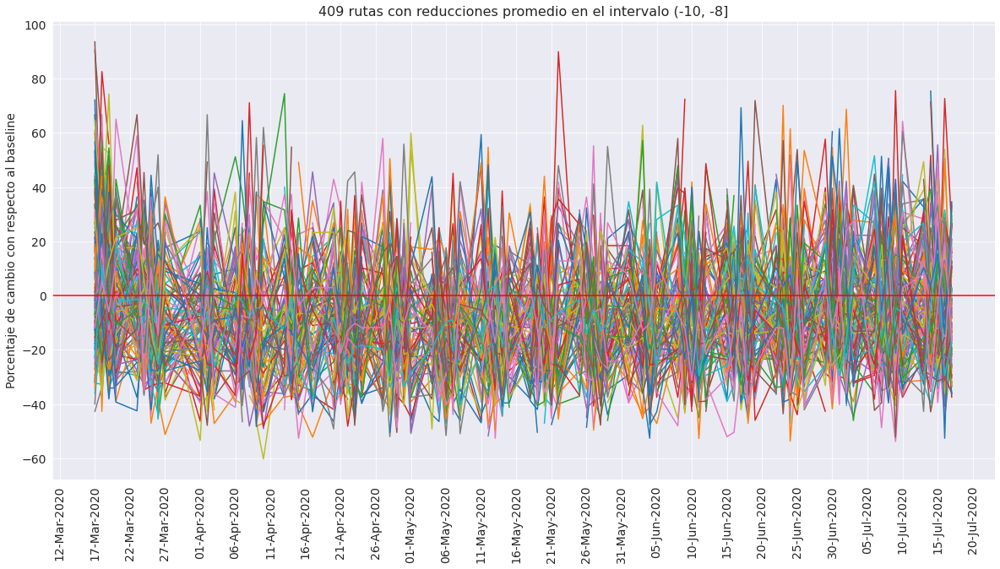

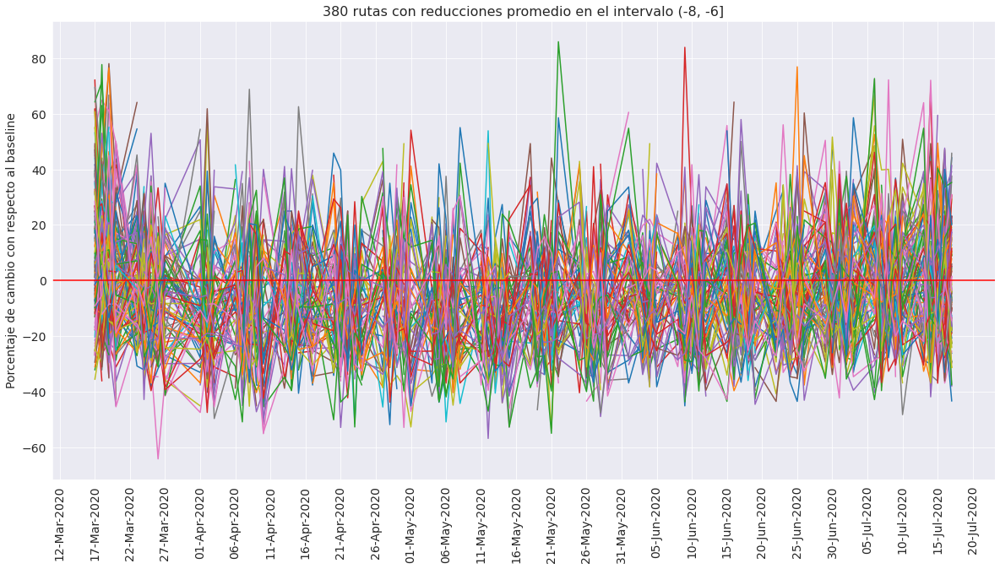

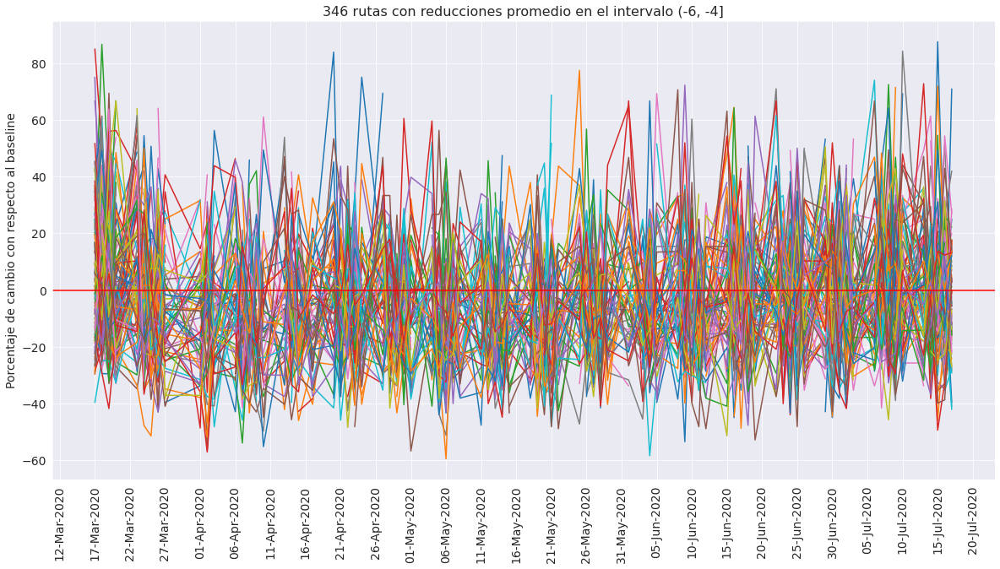

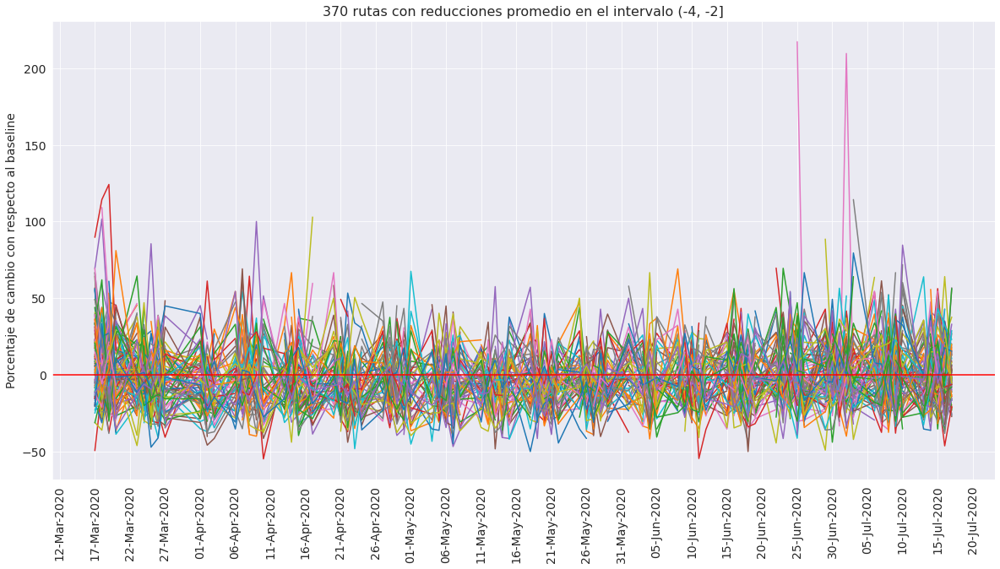

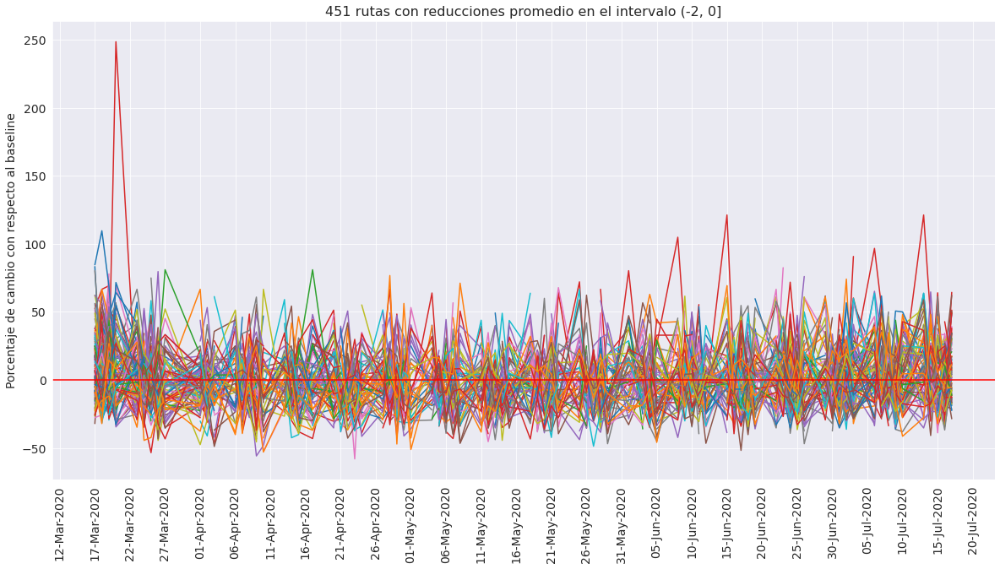

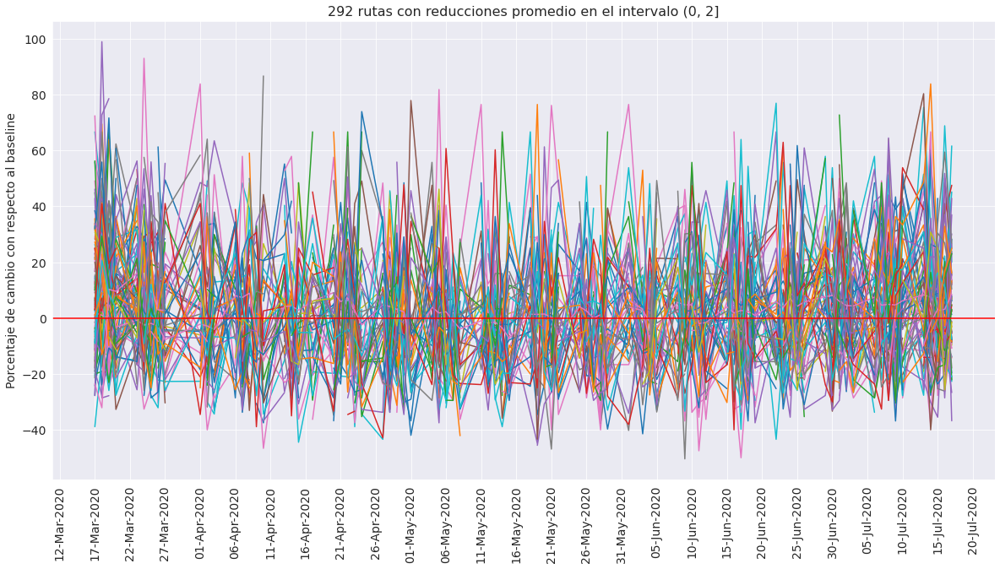

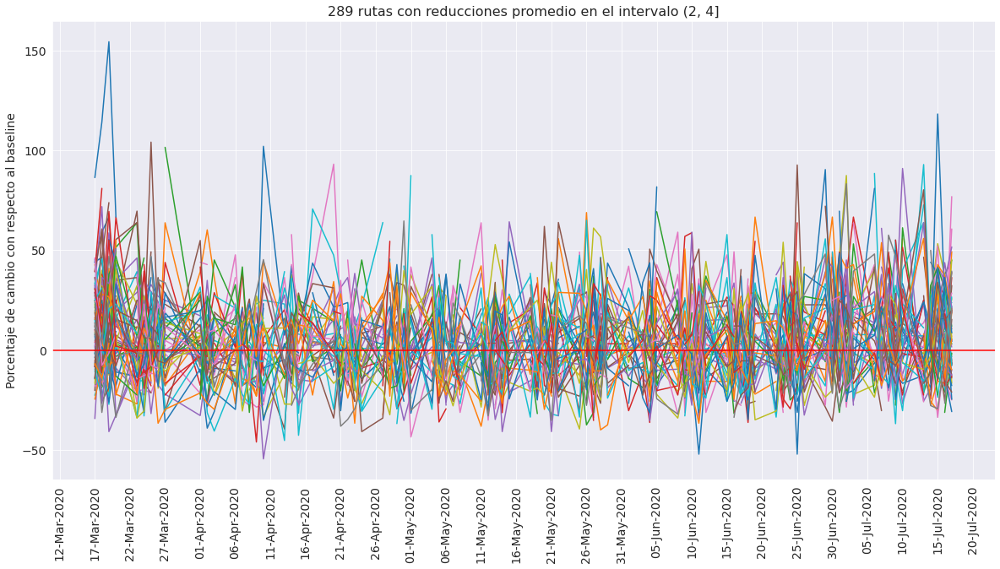

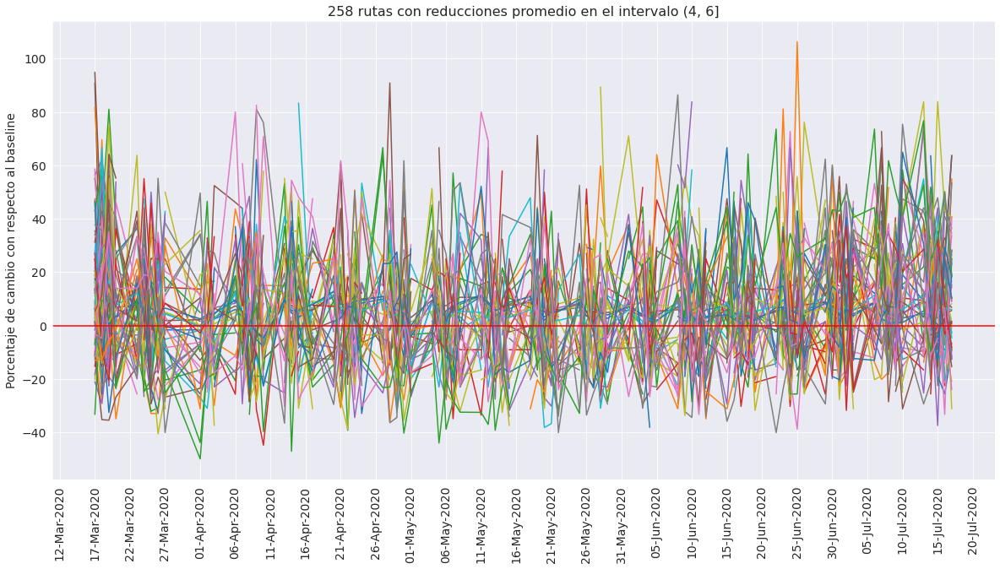

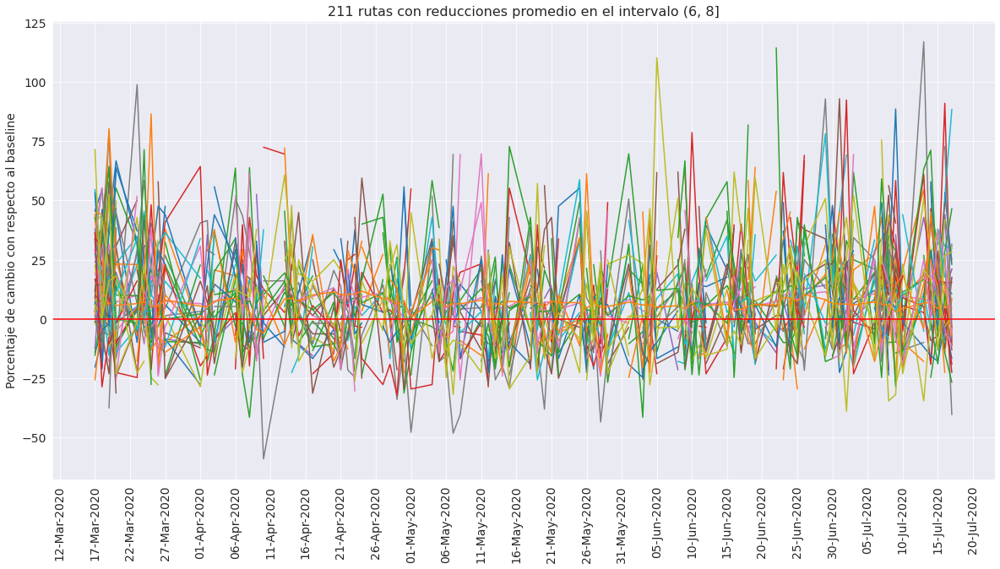

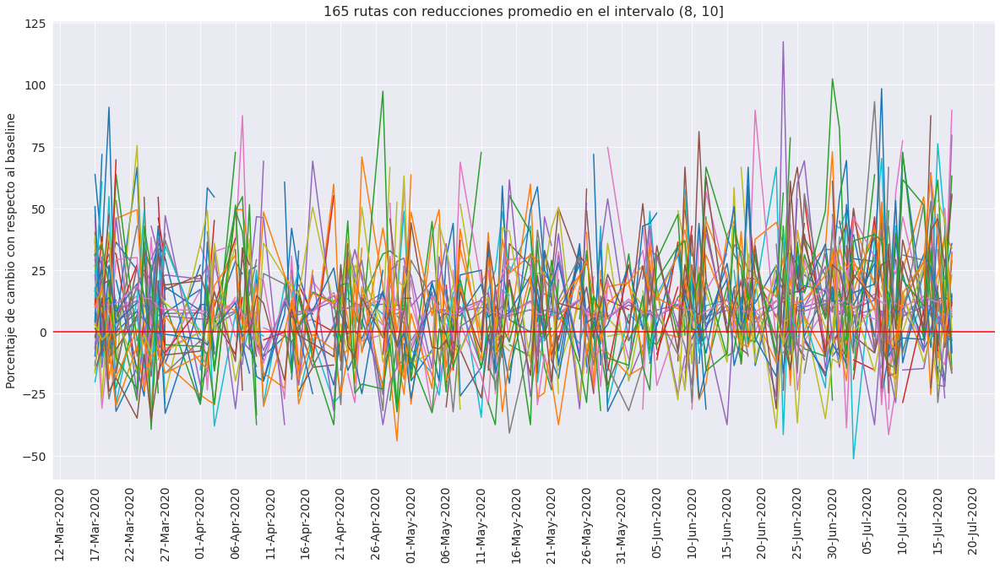

In [26]:
for i in range(0,len(grupos_grafica)):
    rutas = grupos_grafica[i].index 
    sub = [str(rutas.shape[0]), str(subinterval[i])]
    #grafica_cambio_en_en_tiempo_grupos(grupos_grafica[i], rutas, sub)
    grafica_cambio_en_en_tiempo_grupos_estatica(grupos_grafica[i], rutas, sub)

In [27]:
## 3. Rutas por tiles: 00 hrs

In [28]:
### Reshape
rutas_0hr_panel = rutas_0hr.groupby(['ruta', 'fecha']).mean()['percent_change'].unstack()
print(rutas_0hr_panel.shape)
rutas_0hr_panel.head(3)

(20331, 88)


fecha,2020-03-17,2020-03-18,2020-03-19,2020-03-20,2020-03-23,2020-03-24,2020-03-25,2020-03-26,2020-03-27,2020-03-30,...,2020-07-06,2020-07-07,2020-07-08,2020-07-09,2020-07-10,2020-07-13,2020-07-14,2020-07-15,2020-07-16,2020-07-17
ruta,,,,,,,,,,,,,,,,,,,,,
0013 - 0013,31.698955,11.844871,19.009050,23.300971,11.687899,21.688929,34.336463,37.338451,41.459907,13.290251,...,14.111291,32.281122,42.096413,40.877557,45.073714,12.469211,28.804295,39.889294,38.588583,41.190219
0013 - 0028,-13.892078,3.987069,-2.452026,-6.846240,-16.180758,-20.206659,-20.258621,-24.307036,-29.292929,-20.553936,...,-23.469388,-16.188289,-22.952586,-21.108742,-23.681257,-11.078717,-17.336395,-21.875000,-23.240938,-17.508418
0013 - 0061,-39.473684,-14.364641,-10.628019,0.000000,-16.666667,-18.421053,-8.839779,-32.367150,-19.512195,-40.860215,...,-40.860215,-15.789474,-30.939227,-37.198068,-26.829268,-19.354839,-13.157895,-6.077348,-25.120773,9.756098


In [29]:
# Determinacion de los intervalos para los grupos
# Usamos el UMBRAL_CAMBIO_PORCENTUAL
grupo_0h =  rutas_con_reduccion_menor_al_thr(rutas_0hr_panel, UMBRAL_CAMBIO_PORCENTUAL)
print('Número de rutas con reducciones menores al {}% y mayores al {}: {:0,.0f}'.format(-UMBRAL_CAMBIO_PORCENTUAL, UMBRAL_CAMBIO_PORCENTUAL, grupo_0h.shape[0]))

Número de rutas con reducciones menores al 10% y mayores al -10: 4,916


In [30]:
grupos_grafica, subinterval = bins_para_graficar(grupo_16h, UMBRAL_CAMBIO_PORCENTUAL, STEP)

for i in range(0, len(grupos_grafica)):
    print("En el intervalo {} hay {:0,.0f} rutas".format(subinterval[i], grupos_grafica[i].shape[0]) )

En el intervalo (-10, -8] hay 409 rutas
En el intervalo (-8, -6] hay 380 rutas
En el intervalo (-6, -4] hay 346 rutas
En el intervalo (-4, -2] hay 370 rutas
En el intervalo (-2, 0] hay 451 rutas
En el intervalo (0, 2] hay 292 rutas
En el intervalo (2, 4] hay 289 rutas
En el intervalo (4, 6] hay 258 rutas
En el intervalo (6, 8] hay 211 rutas
En el intervalo (8, 10] hay 165 rutas


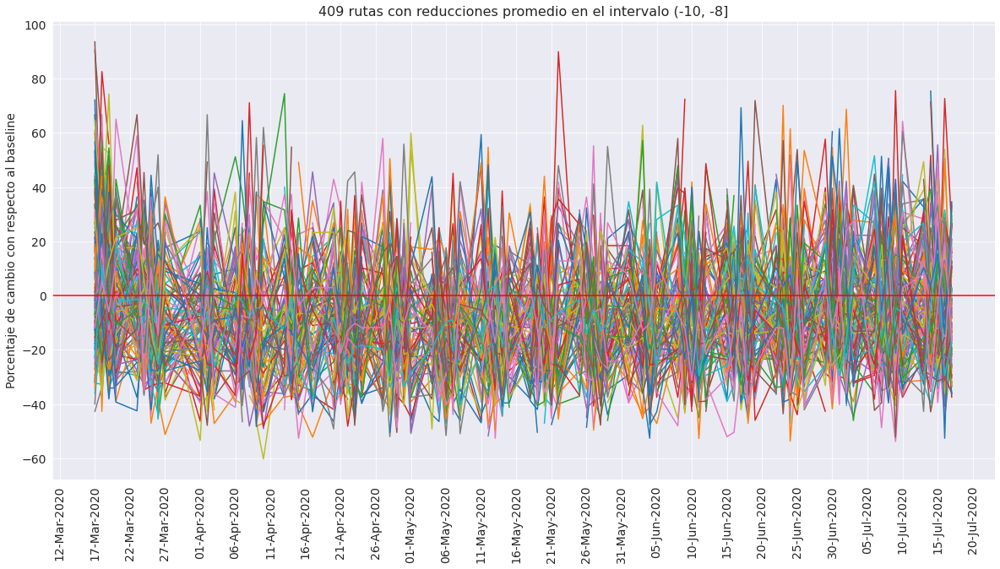

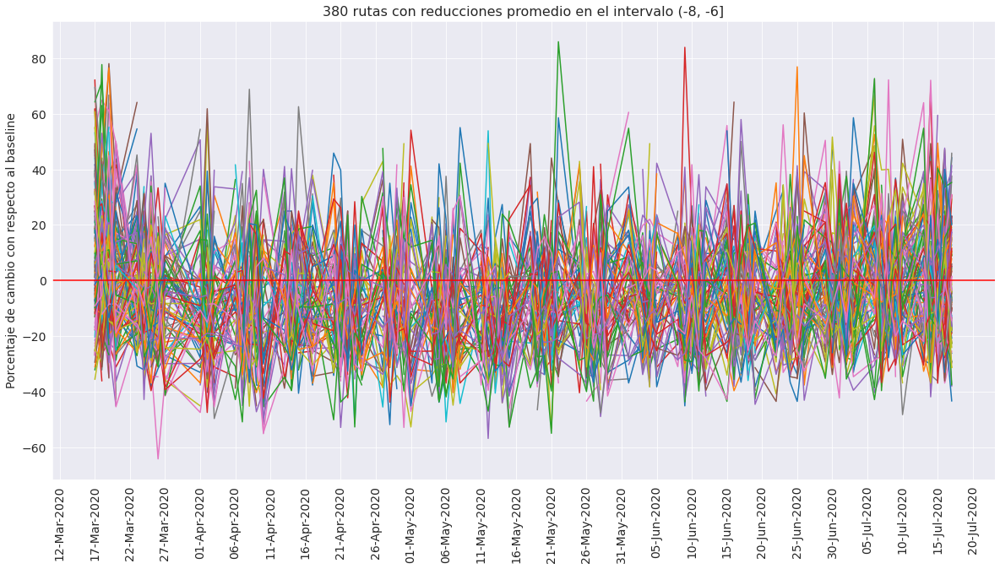

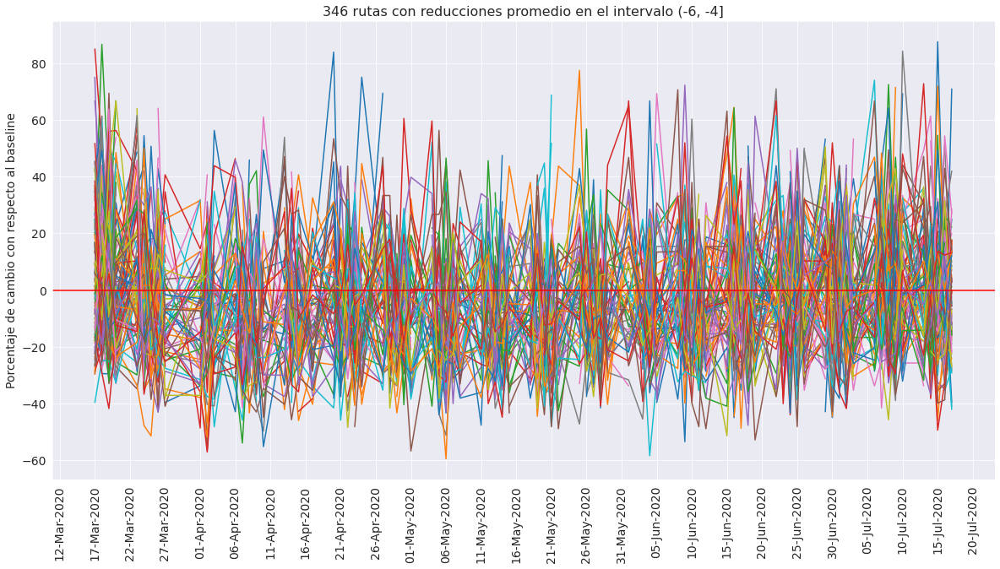

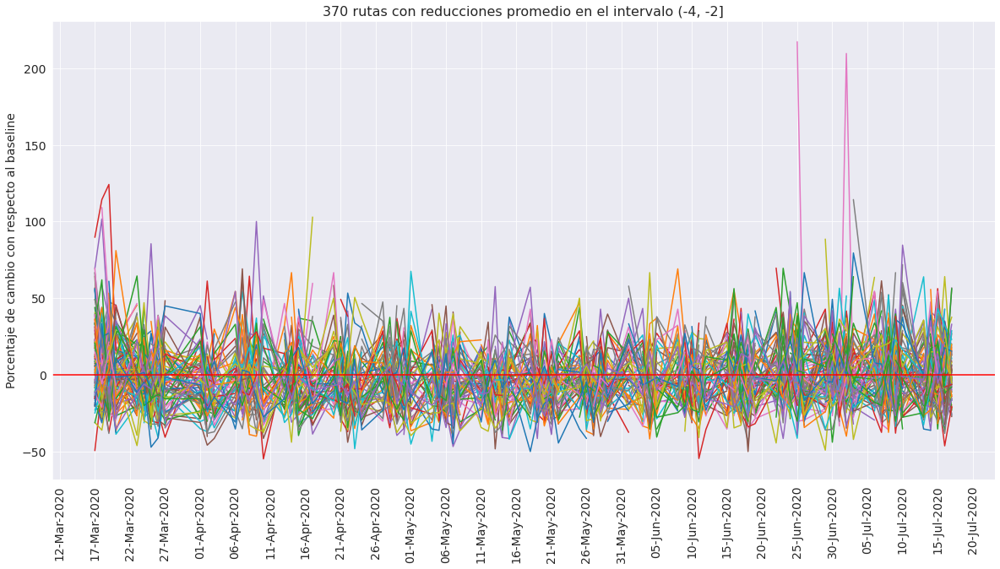

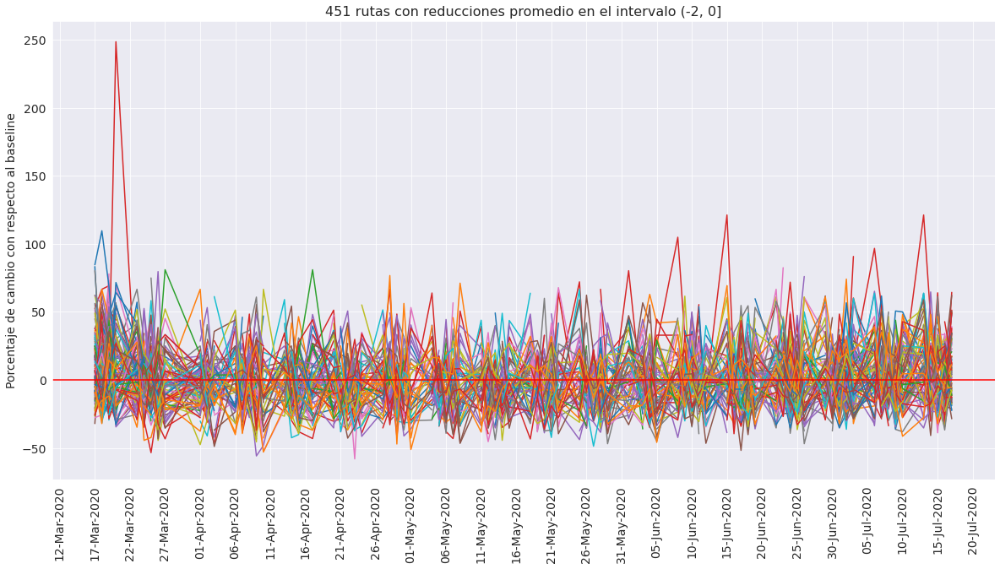

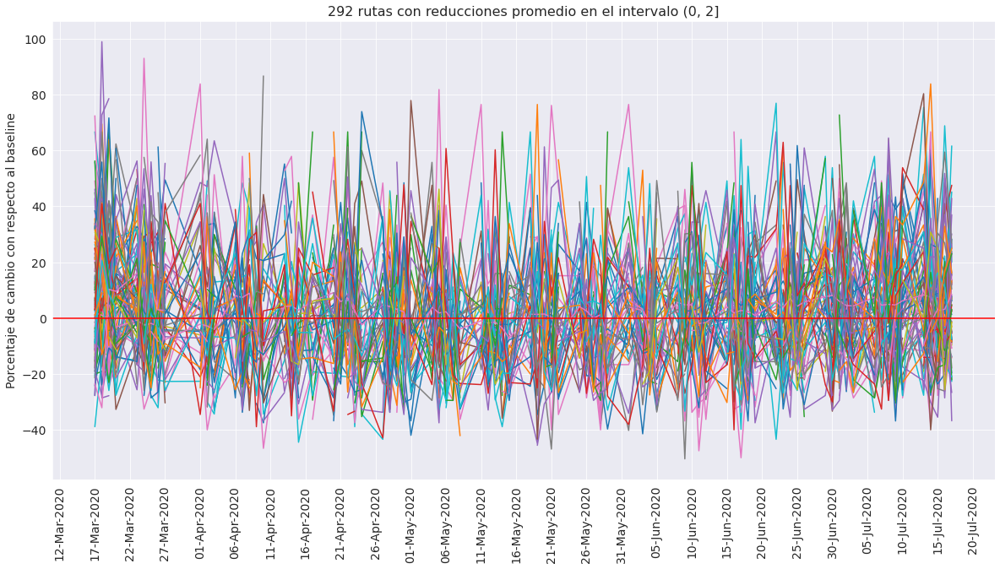

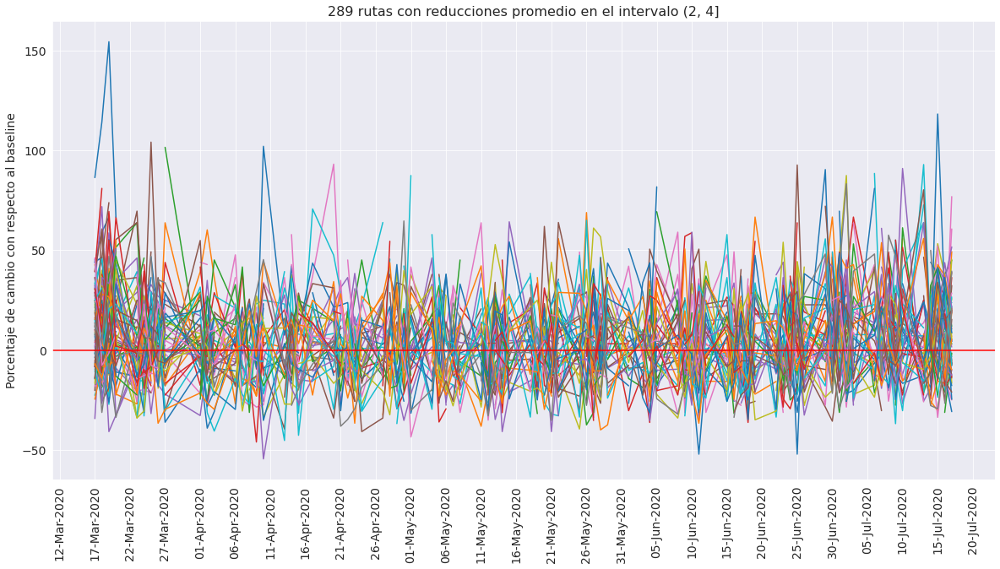

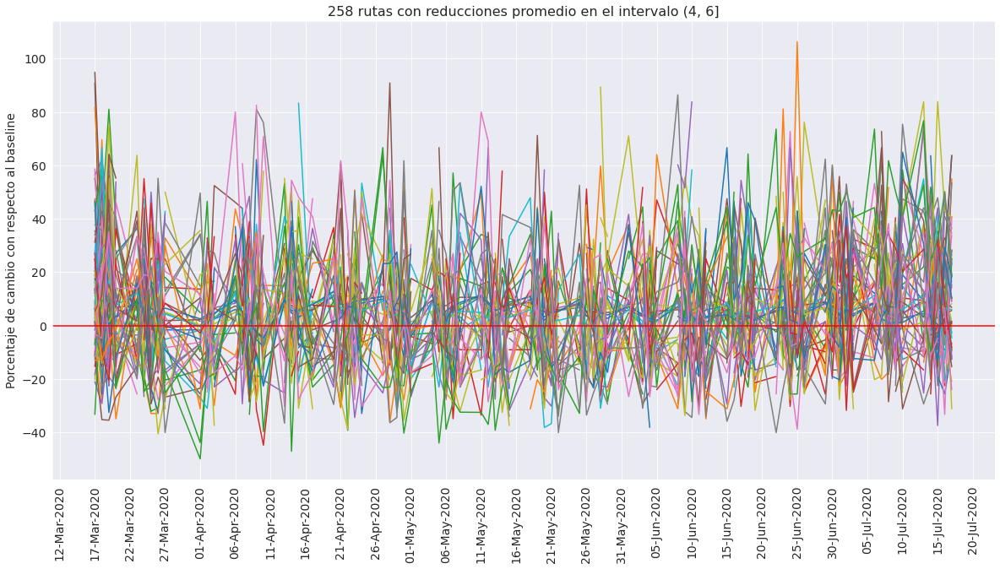

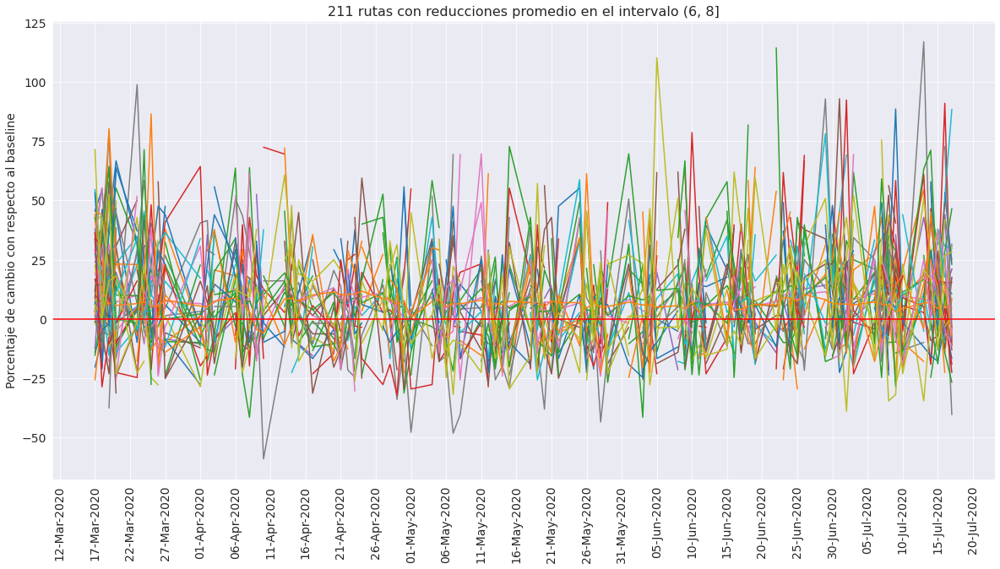

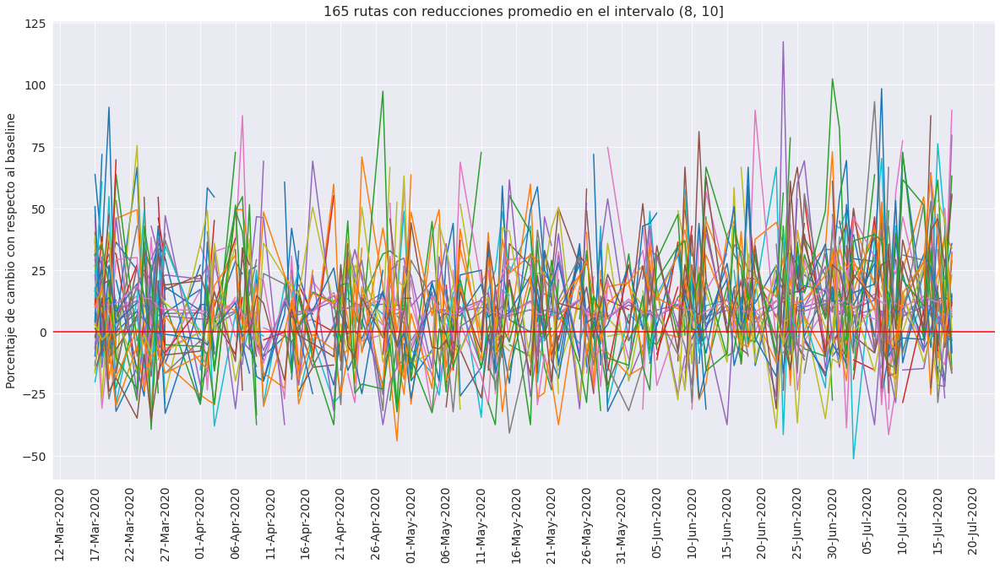

In [31]:
for i in range(0,len(grupos_grafica)):
    rutas = grupos_grafica[i].index 
    sub = [str(rutas.shape[0]), str(subinterval[i])]
    #grafica_cambio_en_en_tiempo_grupos(grupos_grafica[i], rutas, sub)
    grafica_cambio_en_en_tiempo_grupos_estatica(grupos_grafica[i], rutas, sub)